## Orbital Mechanics Simulation
by Lior Shefler

To run:
1) Install the necessary packages
2) Run the first cell
3) Edit the second cell as needed, then run it


## Step 1
Run this cell (do not change anything). 

You only need to run this once. 

In [39]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.integrate import solve_ivp
from IPython.display import HTML

# Constants
G = 6.67430e-11  # m^3 kg^-1 s^-2
AU_TO_M = 1.496e11  # meters per AU

# Default mass values
M_sun = 1.989e30  # kg (mass of Sun)
M_earth = 5.972e24  # kg (mass of Earth)

# Equations of motion for the two-body problem
def equations_of_motion(t, state, M_central):
    x, y, vx, vy = state
    r = np.sqrt(x**2 + y**2)
    ax = -G * M_central * x / r**3
    ay = -G * M_central * y / r**3
    return [vx, vy, ax, ay]

# Function to compute the orbit using numerical integration
def compute_orbit(a, e, M_central_solar, num_orbits=3, num_points=500):
    M_central = M_central_solar * M_sun  # Convert to kg
    a_m = a * AU_TO_M  # Convert AU to meters
    mu = G * M_central
    r_aphelion = a_m * (1 + e)
    v0 = np.sqrt(mu * ((1 - e) / (a_m * (1 + e))))  # Velocity at aphelion
    state0 = [r_aphelion, 0, 0, v0]  # Start at aphelion
    T = 2 * np.pi * np.sqrt(a_m**3 / mu)  # Orbital period
    t_span = (0, num_orbits * T)
    t_eval = np.linspace(0, num_orbits * T, num_points)
    sol = solve_ivp(equations_of_motion, t_span, state0, t_eval=t_eval, args=(M_central,), method='RK45', rtol=1e-9, atol=1e-12)
    return sol.y[0] / AU_TO_M, sol.y[1] / AU_TO_M

# Function to animate and display the orbit in the notebook
def display_orbit_animation(a, e, M_central_solar, M_orbiting_earth):
    x, y = compute_orbit(a, e, M_central_solar)

    fig, ax = plt.subplots(figsize=(5, 5))  
    ax.plot(x, y, label=f'Orbiting Body ({M_orbiting_earth:.2f} Earth Masses)')
    ax.scatter(0, 0, color='orange', s=50, label=f'Central Body ({M_central_solar:.2f} Solar Masses)')
    planet, = ax.plot([], [], 'bo', markersize=6)
    
    ax.set_xlabel('x (AU)')
    ax.set_ylabel('y (AU)')
    ax.legend(loc='upper right')
    ax.set_title(f'Orbital Path (a={a} AU, e={e})')
    ax.grid()
    ax.axis('equal')

    def update(frame):
        planet.set_data(x[frame], y[frame])
        return planet,

    ani = animation.FuncAnimation(fig, update, frames=len(x), interval=30, blit=True)
    return HTML(ani.to_jshtml())

## Step 2
Input desired values for semi major axis, eccentricity, central mass, and orbiting mass. Then, run the cell to display the animation (this may take a minute or two). Ignore any warnings that may pop up.

Repeat for each time you want to change a parameter.

/var/folders/th/dn9qwstn5xb34zz84w8m2yrh0000gn/T/ipykernel_87547/1064744107.py:54: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  planet.set_data(x[frame], y[frame])
/var/folders/th/dn9qwstn5xb34zz84w8m2yrh0000gn/T/ipykernel_87547/1064744107.py:54: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  planet.set_data(x[frame], y[frame])
Animation size has reached 21008813 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


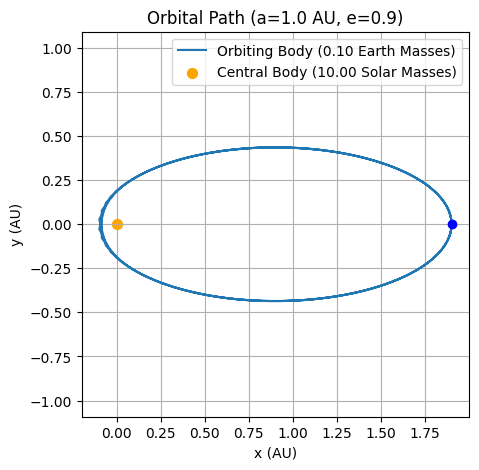

In [38]:
# Manually adjustable parameters
a = 1.0  # Semi-major axis in AU
e = 0.9  # Eccentricity
M_central_solar = 10.0  # Mass of central body in Solar Masses
M_orbiting_earth = .10  # Mass of orbiting body in Earth Masses

# Display the animation
display_orbit_animation(a, e, M_central_solar, M_orbiting_earth)
